# Homework 2

**Daniil Sherki**

MSc-1, Petroleum Engineering

## Question 1 (2 point)

Find minimum (i.e. both the point $x^*$ and the function value $f^* = f(x^*)$) of function with respect
to parameters $a,b,c$:

$$f(x) = ax^2 + bx +c $$

## Solution

Let's find the derivative of $f(x)$.

$$f' = 2ax + b$$

Then we can equate derivative to zero

$$f' = 0: 2ax + b = 0 \Rightarrow x^{*} = \frac{-b}{2a}$$

It's extremum, but we find exactly minimum. Thus, we need to make constraint on $a$ parameter, because this parameter change the direction of the branches of the function, that is, it changes the direction of increasing/decreasing.

How we now it from simple school math, $a>0$ it's condition to make $x^{*}$ a minimum point.

Let's do more complicated math: if $f'(x)<0$ - function is decreasing, if $f'(x)>0$ - function is increasing. And function change direction of increasing/decreasing in extremum point. That means that we have condition to statement: $x*$ is a minimum point.

It is $f'(x^*+\text{d}x) > 0$ and $f'(x^*-\text {d}x) > 0$, but we know that $x^*$ is a extremum, and we need to check only one condtion. Let's check the first one.

$$f'(x^*+\text{d}x) > 0 \Rightarrow 2a ( x^*+\text{d}x ) + b > 0  \Rightarrow 2a(\frac{-b}{2a}+\text{d}x) + b > 0 
\Rightarrow -b + 2a \text{d}x + b > 0 \Rightarrow$$

$$a>0$$


$$f^*(x^*) = ax^* + bx^* + c = a \frac{b^2}{4a^2} + b \cdot (\frac{-b}{2a}) + c = \frac{b^2}{4a} - \frac{b^2}{2a} + c $$
$$ f^*(x^*) = - \frac{b^2}{4a} + c $$

**Answer:** $x^{*} = \frac{-b}{2a}$, $f^*  = - \frac{b^2}{4a} + c $ where $a>0$  

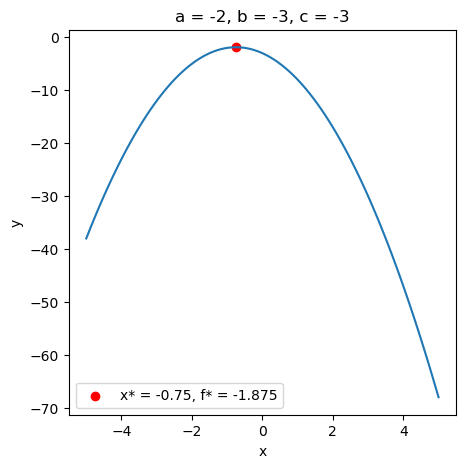

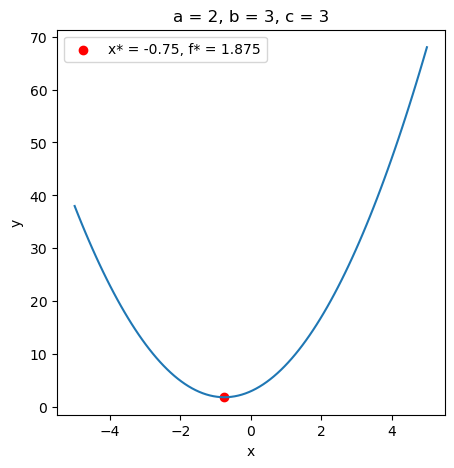

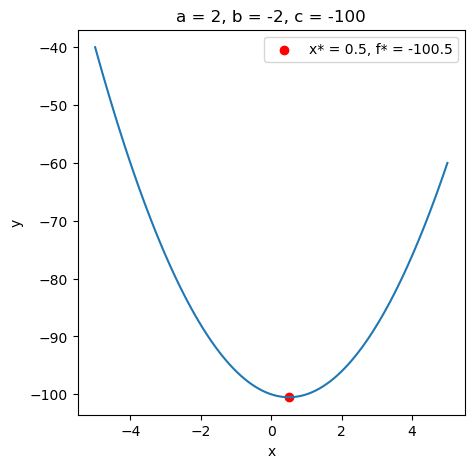

In [1]:
import matplotlib
import matplotlib.pyplot as plt
import numpy as np

x = np.linspace(-5, 5, 100)

a = [-2, 2, 2]
b = [-3, 3, -2]
c = [-3, 3, -100]

def func(x, a, b, c):
    return a * np.power(x, 2) + b * x + c

for i in range(len(a)):
    plt.figure(figsize = (5,5))
    y = func(x, a[i], b[i], c[i])
    plt.plot(x, y)
    x_star = -b[i]/(2*a[i])
    f_star = (-(b[i])**2)/(4*a[i])+c[i]
    plt.scatter(x_star, f_star, label=f'x* = {x_star}, f* = {f_star}', c='r')
    plt.legend()
    plt.title(f'a = {a[i]}, b = {b[i]}, c = {c[i]}')
    plt.xlabel('x')
    plt.ylabel('y')
    plt.show()

## Question 2 (1 point)

What are dimensions of gradient of a function $h(x) = f(Ax)$, constructed of function $f : \mathbb{R}^m → \mathbb{R}$
and matrix $A \in \mathbb{R}^{m \times k}$?

# Solution

There is input vector $\mathbf{x}$ with dimension $\mathbb{R}^m$ and we can represent  operator $\mathbf{A}$ as $A = [a_1, ..., a_m ]^\text{T}$

Input vector equals: $\mathbf{x} = [x_1, \dots, x_k]^{\text{T} } \in \mathbb{R}^{k}$

That means that gradietns of a function wil be equal to number of variables in input vector. The gradient by definition is vector of partial derivatives of all variables.

The gradient of function $h(x)$ will be equal:

$$\nabla_{x} h (\mathbf{x}) =  [\frac{\partial h}{\partial x_1}, \dots,  \frac{\partial h}{\partial x_k} ]^{\text{T} } \in \mathbb{R}^{k} $$


In [2]:
import numpy as np
import jax.numpy as jnp
from jax import grad

m, k = 3, 5

A = np.random.randn(m, k)
x = np.random.randn(k)
x = np.reshape(x, [k, 1])


def func(x):
    return jnp.linalg.norm(A @ x, 2)


df = grad(func)

grad_vector = df(x)

print('h(x) = f(Ax+b) = ||Ax+b||_2')
print(f'A = \n{np.round(A,2)},\n x = \n{np.round(x,2)}')
print(f'h(x) = {round(func(x),2)}')
print(f'grad h(x) = \n{np.round(grad_vector,2)}')
print(f'Gradient vector dimensions is {grad_vector.shape}')

h(x) = f(Ax+b) = ||Ax+b||_2
A = 
[[-1.01  0.69 -0.31  0.48  0.09]
 [-1.31 -1.68  0.42  0.69  0.74]
 [-0.58  1.28 -0.16 -2.21 -0.39]],
 x = 
[[ 0.18]
 [-0.86]
 [ 0.65]
 [ 0.37]
 [ 0.18]]
h(x) = 2.9800000190734863
grad h(x) = 
[[-0.13      ]
 [-2.1699998 ]
 [ 0.45999998]
 [ 1.93      ]
 [ 0.72999996]]
Gradient vector dimensions is (5, 1)


## Question 3 (3 points)

Derive Hessian matrix $\nabla^2_x f(x)$ for the function $f(x) = g(Ax+b)$, assuming differentiable $g$ : $\mathbb{R}^m \rightarrow \mathbb{R}$, with dimensions $ A\in \mathbb{R}^{m \times n}; b \in \mathbb{R}^m; x \in \mathbb{R}^n$.

## Solution

The Hessian matrix or Hessian by definition is a square matrix of second-order partial derivatives of a scalar-valued function, or scalar field (for function of many variables).

In this case there is the same vector as in the previous task. Input vector equals: $\mathbf{x} = [x_1, \dots, x_k]^{\text{T} } \in \mathbb{R}^{n}$

$$\mathbf{H}_{f}={\begin{bmatrix}{\dfrac {\partial ^{2}f}{\partial x_{1}^{2}}}&{\dfrac {\partial ^{2}f}{\partial x_{1}\,\partial x_{2}}}&\cdots &{\dfrac {\partial ^{2}f}{\partial x_{1}\,\partial x_{n}}}\\[2.2ex]{\dfrac {\partial ^{2}f}{\partial x_{2}\,\partial x_{1}}}&{\dfrac {\partial ^{2}f}{\partial x_{2}^{2}}}&\cdots &{\dfrac {\partial ^{2}f}{\partial x_{2}\,\partial x_{n}}}\\[2.2ex]\vdots &\vdots &\ddots &\vdots \\[2.2ex]{\dfrac {\partial ^{2}f}{\partial x_{n}\,\partial x_{1}}}&{\dfrac {\partial ^{2}f}{\partial x_{n}\,\partial x_{2}}}&\cdots &{\dfrac {\partial ^{2}f}{\partial x_{n}^{2}}}\end{bmatrix}}$$

$${(\mathbf {H}_{f})_{i,j}={\frac {\partial ^{2}f}{\partial x_{i}\,\partial x_{j}}}.}
$$

where $i = 1, \dots, n$, $j = 1, \dots, n$

This is general scheme of Hessin matrix for each function.

According to chain rule and [the lecture, slide 7](https://see.stanford.edu/materials/lsocoee364a/review7_single.pdf), we know that


$$ \nabla^2 f(x) = g'(h(x))\nabla^2 h(x) +  g''(h(x)) \nabla f(x) \nabla f(x)^{\text{T} }$$

In our case, when $f(x) = g(Ax+b)$

The second derivative of $f$ is 

$$ \nabla^2 f(x) = A^{\text{T}} \nabla^2 g(Ax+b)A$$

In [3]:
import numpy as np
import jax.numpy as jnp
from jax import hessian

m, n = 3, 4

A = np.random.randn(m, n)
b = np.random.randn(m)
x = np.random.randn(n)
x = np.reshape(x, [n, 1])
b = np.reshape(b, [m, 1])


def func(x):
    return jnp.linalg.norm(A @ x + b, 2)


H = hessian(func)
hess_m = H(x)
hess_m = jnp.reshape(hess_m, [n, n])

print('f(x) = f(Ax+b) = ||Ax+b||_2')
print(f'A = \n{np.round(A,2)},\n b = \n{np.round(b,2)},\n x = \n{np.round(x,2)}')
print(f'f(x) = {round(func(x),2)}')
print(f'Hessian f(x) = \n{np.round(hess_m,2)}')
print(f'Hesian matrix is {hess_m.shape}')

f(x) = f(Ax+b) = ||Ax+b||_2
A = 
[[ 0.03  1.38 -0.78 -0.23]
 [-2.16  1.23 -0.05  0.28]
 [ 0.51 -0.91 -1.18 -2.18]],
 b = 
[[ 1.27]
 [ 0.22]
 [-0.51]],
 x = 
[[ 2.37]
 [-0.37]
 [ 0.03]
 [-1.44]]
f(x) = 7.179999828338623
Hessian f(x) = 
[[ 0.11       -0.06        0.14        0.19      ]
 [-0.06        0.35999998 -0.14999999  0.01      ]
 [ 0.14       -0.14999999  0.19999999  0.22      ]
 [ 0.19        0.01        0.22        0.35999998]]
Hesian matrix is (4, 4)


## Question 4 (3 points)

Solve an optimal step size problem for the quadratic function, with symmetric positive definite
matrix $A \succ 0 \in \mathbb{R}^{n \times n}$, and $x,b,d \in \mathbb{R}^n$. Your goal is to find optimal $\gamma^*$ for given $A,b,d,x$. The
resulting expression must be written in terms of inner products $(...,...)$
$$f (\gamma) = (A(x + \gamma d) ,x + \gamma d) + (b,x + \gamma d) \rightarrow \min_{\gamma \in \mathbb{R}}$$

## Solution

$$\nabla_{\gamma} f = \nabla_{\gamma}(A(x + \gamma d) ,x + \gamma d) + \nabla_{\gamma}(b,x + \gamma d)$$

$$\nabla_{\gamma} f = (\nabla_{\gamma}(A(x + \gamma d)) ,x + \gamma d) + (A(x + \gamma d) ,\nabla_{\gamma}(x + \gamma d)) + (\nabla_{\gamma}b,x + \gamma d)+ (b,\nabla_{\gamma}(x + \gamma d))$$

$$\nabla_{\gamma} f = (Ad ,x + \gamma d) + (A(x + \gamma d) ,d) + (0 ,x + \gamma d)+ (b,d)$$

$$\nabla_{\gamma} f = (Ad ,x) + (Ad, \gamma d) + (Ax,d) + (A \gamma d ,d) + (0 ,x + \gamma d)+ (b,d)$$

$$\nabla_{\gamma} f = (Ad ,x) + \gamma (Ad, d) + (Ax,d) +  \gamma (A d ,d) + (b,d)$$

$$\nabla_{\gamma} f =\gamma ((Ad, d) + (Ad ,d)) + ((Ad ,x) + (Ax,d) + (b,d)) $$

We know that optimum point will be achieve when $\nabla_{\gamma} f = 0$

$$\gamma ((Ad, d) + (Ad ,d)) + ((Ad ,x) + (Ax,d) + (b,d)) = 0$$

$$\gamma  = - \dfrac{(Ad ,x) + (Ax,d) + (b,d)}{(Ad, d) + (Ad ,d)}$$

$$\gamma  = - \dfrac{((A+A^{\top})d,x) + (b,d)}{2(Ad, d))}$$

$A$ - positive-definite (e.g. symmetric) $ \Rightarrow A = A^{\top}$

$$\gamma  = - \dfrac{2(Ad,x) + (b,d)}{2(Ad, d)}$$

$$\nabla_{\gamma} f =2(Ad,d)\gamma  + ((Ad ,x) + (Ax,d) + (b,d)) $$

$$\nabla^2_{\gamma} f =\nabla^2_{\gamma} (2(Ad,d)\gamma)  + \nabla^2_{\gamma} (((Ad ,x) + (Ax,d) + (b,d))) $$

$$\nabla^2_{\gamma} f = 2(Ad,d) = 2 d^{\top} A d $$

$$\nabla^2_{\gamma} f = 2A $$

$$\nabla^2_{\gamma} f \succ 0 \text{ so } A \succ 0 \text{ (PSD)} $$

## Question 5 (3 points)

Derive subgradient (subdifferential) for the function $f(x) = [x^2 −1]_+,x \in \mathbb{R}$. (Do not write the
subgradient method.)

## Solution

$\begin{equation*}
\partial f(x) = 
 \begin{cases}
   -2x, \text{ } x \leq -1 \\
   [-2x;2x], \text{ } -1 < x < 1 \\
   2x, \text{ } x \geq 1 \\
 \end{cases}
\end{equation*}
$

## Question 6 (5 points)

Find the minimizer of

$$f(x,y) = x^2 + xy + 10y^2 −22y −5x$$
numerically by steepest descent.
1. For each iteration, record the values of x,y, and f and include in a table.
2. Plot the values on a contour plot.
3. Explore different starting values, such as (1, 10), (10, 10), (10, 1). Does the number of steps
depend significantly on the starting guess?

In [4]:
import jax
import pandas as pd
import matplotlib.pyplot as plt
from scipy.optimize import fminbound


def task5_func(x):
    return np.power(x[0], 2) + x[0]*x[1] + 10 * np.power(x[1], 2) - 22*x[1] - 5*x[0]


def task5_grad(x):
    dfdx = 2 * x[0] + x[1] - 5
    dfdy = x[0] + 2*10 * x[1] - 22
    return np.array([dfdx, dfdy])


def gradient_descent(x0, gamma, tol, func=task5_func, grad_func=task5_grad, adapt_gamma=False, gamma_max=0.1):
    x = x0
    x_prev = np.zeros_like(x)
    k = 0

    x_arr = [x[0]]
    y_arr = [x[1]]
    f_arr = [func(x)]
    k_arr = [k]
    gamma_arr = [gamma]

    while np.linalg.norm(x - x_prev, 2) > tol:
        x_prev = x
        if adapt_gamma:
            def gamma_adapt(gamma):
                dx = 2 * x[0] + x[1] - 5
                dy = x[0] + 2*10 * x[1] - 22
                xx = x[0] - gamma*(2 * x[0] + x[1] - 5)
                yy = x[1] - gamma*(x[0] + 2*10 * x[1] - 22)
                z = int(xx**2 + xx*yy + 10 * yy**2 - 22*yy - 5*xx)
                return z
            gamma = fminbound(gamma_adapt, 0, gamma_max,
                              xtol=1e-02, maxfun=100)
            gamma_arr.append(gamma)
        k += 1
        x = x - gamma*grad_func(x)

        x_arr.append(x[0])
        y_arr.append(x[1])
        f_arr.append(func(x))
        k_arr.append(k)

    if adapt_gamma:
        df = pd.DataFrame({'step': k_arr, 'x': x_arr,
                          'y': y_arr, 'f': f_arr, 'gamma': gamma_arr})
    else:
        df = pd.DataFrame({'step': k_arr, 'x': x_arr, 'y': y_arr, 'f': f_arr})
    return x, func(x), k, df

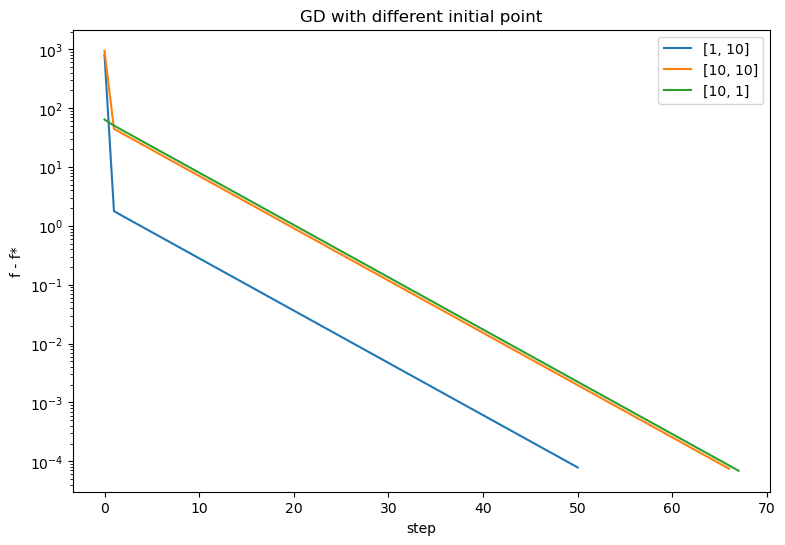

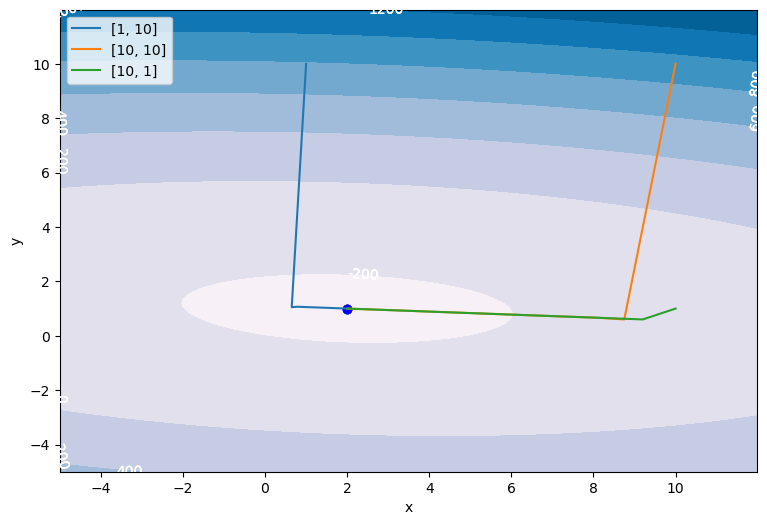

In [5]:
init_points = [[1, 10], [10, 10], [10, 1]]

xmin, xmax, step = -5, 12, 0.01
x = np.arange(xmin, xmax, step)
y = np.arange(xmin, xmax, step)
xgrid, ygrid = np.meshgrid(x, y)
zgrid = task5_func([xgrid, ygrid])

fig = plt.figure(figsize = (9, 6))
ax1 = fig.add_subplot()
fig = plt.figure(figsize = (9, 6))
ax2 = fig.add_subplot()
count_chart = ax2.contourf(xgrid, ygrid, zgrid, cmap='PuBu')
for init in init_points:
    _, y_star, _, df = gradient_descent(
        np.array(init), 0.05, 1e-3, adapt_gamma=False)
    df['f_fst'] = df['f']+16
    ax1.plot(df.step, df.f_fst, label=f'{init}')
    ax2.plot(df.x, df.y, label=f'{init}')
    plt.clabel(count_chart, inline=0, fontsize=10, colors='white', fmt='%1.0f')
    ax2.scatter(2, 1, c='b')
    ax1.set_yscale('log')
ax1.set_xlabel('step')
ax1.set_ylabel('f - f*')
ax1.set_title(f'GD with different initial point')
ax1.legend()
ax2.set_xlabel('x')
ax2.set_ylabel('y')
ax2.legend()
plt.show()

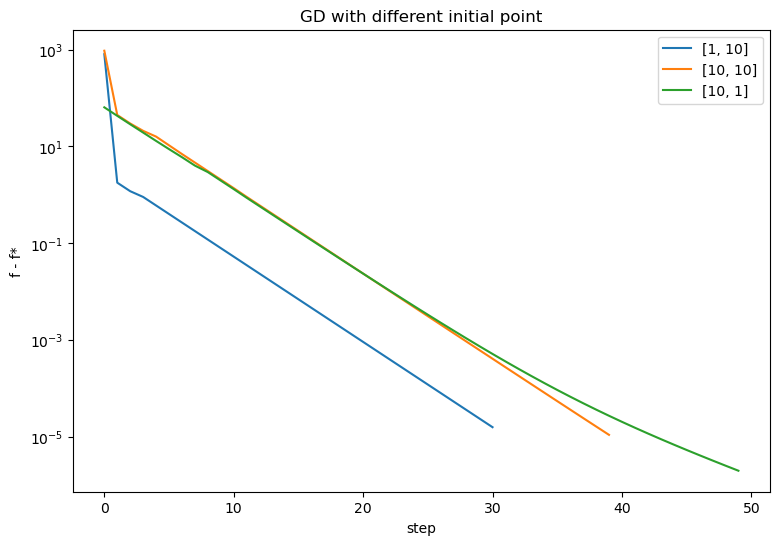

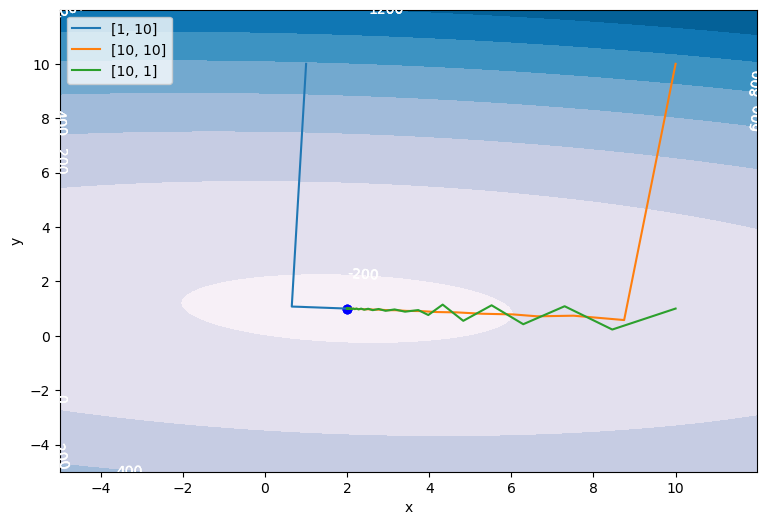

In [6]:
init_points = [[1, 10], [10, 10], [10, 1]]

xmin, xmax, step = -5, 12, 0.01
x = np.arange(xmin, xmax, step)
y = np.arange(xmin, xmax, step)
xgrid, ygrid = np.meshgrid(x, y)
zgrid = task5_func([xgrid, ygrid])

fig = plt.figure(figsize = (9, 6))
ax1 = fig.add_subplot()
fig = plt.figure(figsize = (9, 6))
ax2 = fig.add_subplot()
count_chart = ax2.contourf(xgrid, ygrid, zgrid, cmap='PuBu')
for init in init_points:
    _, y_star, _, df = gradient_descent(
        np.array(init), 0.05, 1e-3, adapt_gamma=True, gamma_max=0.1)
    df['f_fst'] = df['f']+16
    ax1.plot(df.step, df.f_fst, label=f'{init}')
    ax2.plot(df.x, df.y, label=f'{init}')
    plt.clabel(count_chart, inline=0, fontsize=10, colors='white', fmt='%1.0f')
    ax2.scatter(2, 1, c='b')
    ax1.set_yscale('log')
ax1.set_xlabel('step')
ax1.set_ylabel('f - f*')
ax1.set_title(f'GD with different initial point')
ax1.legend()
ax2.set_xlabel('x')
ax2.set_ylabel('y')
ax2.legend()
plt.show()

In [7]:
import plotly.express as px

px.line(data_frame=df, x = 'step', y =  'gamma', title = 'Gamma changing step-by-step plot')

### Question 7 (9 points)

Let the cost function of the unconstrained optimization problem of interest be:
$$f(x) = \frac{1}{4}(x_1 −1)^2 + \sum^n_{i=2}(2x^2_{i-1}-x_i-1)^2$$
Consider two different scenarios, first $n = 3$, and then $n = 10$. Recall that the steepest descent
algorithm is,
$$x^{k+1} = x^k − \alpha^k \nabla f(x^k), \alpha^k \in \mathbb{R}_{>0}$$
1. Using $x^0 = [−1.5,1,...,1]^{\top}$ write out the first iteration of the steepest descent algorithm and obtain the optimum value for $\alpha^0$. What is the value of $x^1$ if you implement $\alpha^0$? Verify that $f(x^1) < f(x^0)$.
2. Write a code to find the minimizer of f(x) using steepest descent algorithm with starting point of $x^0 = [−1.5,1,...,1]^{\top}$ and using
* $\alpha^k = \text{argmin } f(x^k − \alpha \nabla f(x^k))$
* constant $\alpha = 0.1$
* constant $\alpha = 0.5$
* constant $\alpha = 1.0$ (Use $ \Vert x^{k+1}−x^k \Vert \leq 10^{−6}$ as the stopping condition for your algorithm.)
3. How many steps does it take for the algorithm to converge for each choice of the step size above?
4. Use fminbnd from Matlab or an equivalent function from the programming language of your choice to solve the problem. How many steps does it take for this algorithm to converge?

In [8]:
import jax.numpy as jnp

def task7_func(x):
    sum_x = 0
    for i in range(1,len(x)):
        sum_x += jnp.power(2*jnp.power(x[i-1],2)-x[i]-1,2)
    out = 0.25*jnp.power(x[0] - 1,2) + sum_x
    return out

In [9]:
import numpy as np

def task7_func_analyt(x):
    sum_x = 0
    for i in range(1,len(x)):
        sum_x += np.power(2*np.power(x[i-1],2)-x[i]-1,2)
    out = 0.25*np.power(x[0] - 1,2) + sum_x
    return out

In [10]:
x3 = np.array([-1.5,1,1])
x10 = np.array([-1.5,1,1,1,1,1,1,1,1,1])

In [11]:
def task7_grad_analyt(x):
  grad_vec = np.zeros_like(x)
  grad_vec[0] = 0.5 * (x[0]-1) + 16*x[0]**3 - 8 * x[0]*x[1] - 8*x[0]
  for i in range(1, len(grad_vec)-1):
    grad_vec[i] = 2*x[i] + 2 - x[i-1]**2 * 4 + x[i]**3 * 16 - 8 * x[i]*x[i+1] - 8*x[i]
  j = len(grad_vec)-1
  grad_vec[j] = 2*x[j] + 2 - 4 * x[j-1]**2 
  return grad_vec
task7_grad_analyt(x3), task7_grad_analyt(x10)

(array([-31.25,  -5.  ,   0.  ]),
 array([-31.25,  -5.  ,   0.  ,   0.  ,   0.  ,   0.  ,   0.  ,   0.  ,
          0.  ,   0.  ]))

In [12]:
task7_grad = jax.grad(task7_func)
task7_grad(x3), task7_grad(x10)

(DeviceArray([-31.25,  -5.  ,   0.  ], dtype=float32),
 DeviceArray([-31.25,  -5.  ,   0.  ,   0.  ,   0.  ,   0.  ,   0.  ,
                0.  ,   0.  ,   0.  ], dtype=float32))

In [13]:
def jax_gradient_descent(x0, gamma, tol, func=task7_func_analyt, grad_func=task7_grad_analyt,
                         adapt_gamma=False, gamma_max=1, adapt_auto=True, c1 = 0.01, gamma_step = 0.01):
    x = x0
    x_prev = np.zeros_like(x)
    k = 0
    k1 = 0
    brut_force = False

    x_arr = [x]
    f_arr = [func(x)]
    k_arr = [k]
    k1_arr  = [k1]
    gamma_arr = [gamma]

    while np.linalg.norm(x - x_prev, 2) > tol:
        x_prev = x
        if adapt_gamma:
            if adapt_auto:
                def gamma_adapt(gamma):
                    z = func(x - gamma*grad_func(x))
                    return z
                gamma,_,_,k1 = fminbound(gamma_adapt, 0, gamma_max,
                                  xtol=1e-05, maxfun=100, full_output=True)
                k1_arr.append(k1)
                gamma_arr.append(gamma)
                print(x)
            else:
                k1 = 0
                gamma = gamma_max
                grad_val = grad_func(x)
                while func(x - gamma*grad_val)>(func(x) - c1 * gamma * np.dot(grad_val.T, grad_val)):
                    gamma -= gamma_step
                    k1 += 1
                k1_arr.append(k1)
                gamma_arr.append(gamma)
        k += 1
        x = x - gamma*grad_func(x)

        x_arr.append(x)
        f_arr.append(func(x))
        k_arr.append(k)
        
    if adapt_gamma:
        df = pd.DataFrame({'step': k_arr, 'f': f_arr, 'gamma': gamma_arr, 'k1': k1_arr})
    else:
        df = pd.DataFrame({'step': k_arr, 'f': f_arr})
    return x, func(x), k, df, x_arr

##1 subtask

In [14]:
x3 = np.array([-1.5, 1, 1])
y3_0 = task7_func_analyt(x3)
x10 = np.array([-1.5, 1, 1, 1, 1, 1, 1, 1, 1, 1])
y10_0 = task7_func_analyt(x10)

gamma = 1
grad_val = task7_grad_analyt(x3)
while task7_func_analyt(x3 - gamma*grad_val) > (task7_func_analyt(x3) - 0.01 * gamma * np.dot(grad_val.T, grad_val)):
    gamma -= 0.0005
print(gamma)

x3 = x3 - gamma*task7_grad_analyt(x3)

print('3-dim case\n')
print(f'x1 = {x3}')
if task7_func(x3) < y3_0:
    print(f'f(x1)<f(x0), {task7_func_analyt(x3):.2f}<{y3_0:.2f}\n')

gamma = 1
grad_val = task7_grad_analyt(x10)
while task7_func_analyt(x10 - gamma*grad_val) > (task7_func_analyt(x10) - 0.01 * gamma * np.dot(grad_val.T, grad_val)):
    gamma -= 0.0005
print(gamma)

print('10-dim case\n')
x10 = x10 - gamma*task7_grad_analyt(x10)
print(f'x1 = {x10}')
if task7_func(x10) < y10_0:
    print(f'f(x1)<f(x0), {task7_func_analyt(x10):.2f}<{y10_0:.2f}')

0.0915000000000547
3-dim case

x1 = [1.359375 1.4575   1.      ]
f(x1)<f(x0), 6.62<7.81

0.0915000000000547
10-dim case

x1 = [1.359375 1.4575   1.       1.       1.       1.       1.       1.
 1.       1.      ]
f(x1)<f(x0), 6.62<7.81


## Solution for 3 points

### Case 1: $\alpha^k = \text{argmin } f(x^k − \alpha \nabla f(x^k))$ (manually)

In [15]:
x = np.array([-1.5,1,1])
_, _, _, df_3c1,x_arr = jax_gradient_descent(x, 0.5, 1e-6,
                                             adapt_gamma=True,
                                             adapt_auto=False,
                                             c1=0.01,
                                             gamma_max = 0.5,
                                             gamma_step = 0.005)

In [16]:
df_3c1

,step,f,gamma,k1
0,0,7.812500e+00,0.500,0
1,1,5.877086e+00,0.090,82
2,2,4.266347e+00,0.125,75
3,3,3.763706e+00,0.035,93
4,4,3.053563e+00,0.075,85
...,...,...,...,...
63465,63465,8.256501e-09,0.045,91
63466,63466,8.256039e-09,0.050,90
63467,63467,8.253617e-09,0.045,91
63468,63468,8.253144e-09,0.050,90


In [17]:
import plotly.express as px

px.line(data_frame=df_3c1, x = 'step', y =  'gamma',
        title = 'Gamma changing step-by-step plot',
        log_y = True)

In [18]:
px.line(data_frame=df_3c1, x = 'step', y =  'k1',
        title = 'Iteration number for each step for optimal alpha searching',
        log_y = True)

In [19]:
px.line(data_frame=df_3c1, x = 'step', y =  'f',
        title = 'Function value for each step',
        log_y = True)

In [20]:
x_arr[-1]

array([0.99981956, 0.9992686 , 0.99707135])

### Case 2: $\alpha^k = \text{argmin } f(x^k − \alpha \nabla f(x^k))$ (fminbound)


In [21]:
x = np.array([-1.5,1,1])

_, _, _, df_3c2,x_arr = jax_gradient_descent(x, 0.5, 1e-6,
                                             adapt_gamma=True,
                                             adapt_auto=True)

[-1.5  1.   1. ]
[0.98695921 1.39791347 1.        ]
[1.04570933 1.0306176  1.06302993]
[1.0046167  1.02466794 1.06681531]
[1.00580381 1.01753755 1.06847939]
[1.00419723 1.01730478 1.0686289 ]
[1.004242   1.01703451 1.06868931]
[1.00418028 1.01702472 1.06869123]
[1.00418215 1.01701281 1.06869053]
[1.00417462 1.01701222 1.06868028]
[1.00417993 1.01700771 1.06867663]
[1.00417595 1.01701058 1.06866727]
[1.00417932 1.01700472 1.06866404]
[1.00417507 1.01700741 1.06865475]
[1.00417855 1.01700164 1.06865149]
[1.00417433 1.01700433 1.0686422 ]
[1.0041778  1.01699855 1.06863894]
[1.00417357 1.01700125 1.06862965]
[1.00417704 1.01699547 1.06862639]
[1.00417281 1.01699817 1.0686171 ]
[1.00417628 1.01699239 1.06861385]
[1.00417206 1.01699509 1.06860455]
[1.00417553 1.01698931 1.0686013 ]
[1.0041713  1.016992   1.06859201]
[1.00417477 1.01698623 1.06858876]
[1.00417055 1.01698892 1.06857947]
[1.00417402 1.01698315 1.06857622]
[1.00416979 1.01698584 1.06856693]
[1.00417326 1.01698007 1.06856368]
[1.

[1.00073882 1.00300139 1.0120353 ]
[1.00073793 1.0030018  1.012033  ]
[1.00073865 1.00300069 1.01203252]
[1.00073776 1.00300111 1.01203022]
[1.00073848 1.003      1.01202974]
[1.00073759 1.00300041 1.01202744]
[1.00073831 1.00299931 1.01202696]
[1.00073742 1.00299972 1.01202466]
[1.00073814 1.00299861 1.01202417]
[1.00073724 1.00299903 1.01202188]
[1.00073797 1.00299792 1.01202139]
[1.00073707 1.00299834 1.0120191 ]
[1.0007378  1.00299723 1.01201861]
[1.0007369  1.00299764 1.01201632]
[1.00073763 1.00299654 1.01201583]
[1.00073673 1.00299695 1.01201354]
[1.00073746 1.00299585 1.01201305]
[1.00073656 1.00299626 1.01201076]
[1.00073729 1.00299515 1.01201027]
[1.00073639 1.00299557 1.01200798]
[1.00073712 1.00299446 1.01200749]
[1.00073622 1.00299487 1.0120052 ]
[1.00073695 1.00299377 1.01200472]
[1.00073605 1.00299418 1.01200242]
[1.00073678 1.00299308 1.01200194]
[1.00073588 1.00299349 1.01199964]
[1.00073661 1.00299239 1.01199916]
[1.00073571 1.0029928  1.01199686]
[1.00073644 1.002991

In [22]:
df_3c2

,step,f,gamma,k1
0,0,7.812500e+00,0.500000,0
1,1,3.844007e+00,0.079583,16
2,2,2.874237e-02,0.016514,21
3,3,1.137110e-03,0.030868,12
4,4,4.665201e-05,0.025157,11
...,...,...,...,...
21460,21460,6.197278e-08,0.029148,7
21461,21461,6.195562e-08,0.125281,6
21462,21462,6.193846e-08,0.029147,7
21463,21463,6.192130e-08,0.125300,6


In [23]:
px.line(data_frame=df_3c2, x = 'step', y =  'gamma', title = 'Gamma changing step-by-step plot',log_y = True)

In [24]:
px.line(data_frame=df_3c2, x = 'step', y =  'k1', title = 'Iteration number for each step for optimal alpha searching',log_y = True)

In [25]:
px.line(data_frame=df_3c2, x = 'step', y =  'f', title = 'Function value for each step',log_y = True)

In [26]:
x_arr[-1]

array([1.0004937 , 1.00200544, 1.00803755])

### Case 3: $\alpha = 0.1$

In [27]:
x = np.array([-1.5,1,1])
_, _, _, df_3c3,x_arr = jax_gradient_descent(x, 0.1, 1e-6, adapt_gamma=False)

/var/folders/fc/8vk24n953y36xydr3hkmr9y00000gn/T/ipykernel_71893/3773990786.py:6: RuntimeWarning:

overflow encountered in power

/var/folders/fc/8vk24n953y36xydr3hkmr9y00000gn/T/ipykernel_71893/3773990786.py:7: RuntimeWarning:

overflow encountered in power

/var/folders/fc/8vk24n953y36xydr3hkmr9y00000gn/T/ipykernel_71893/1581741728.py:3: RuntimeWarning:

overflow encountered in double_scalars

/var/folders/fc/8vk24n953y36xydr3hkmr9y00000gn/T/ipykernel_71893/1581741728.py:3: RuntimeWarning:

invalid value encountered in double_scalars

/var/folders/fc/8vk24n953y36xydr3hkmr9y00000gn/T/ipykernel_71893/1581741728.py:5: RuntimeWarning:

overflow encountered in double_scalars

/var/folders/fc/8vk24n953y36xydr3hkmr9y00000gn/T/ipykernel_71893/1581741728.py:5: RuntimeWarning:

invalid value encountered in double_scalars

/var/folders/fc/8vk24n953y36xydr3hkmr9y00000gn/T/ipykernel_71893/1581741728.py:7: RuntimeWarning:

overflow encountered in double_scalars



In [28]:
df_3c3

,step,f
0,0,7.812500e+00
1,1,1.408301e+01
2,2,6.872906e+01
3,3,6.382117e+04
4,4,1.052642e+14
5,5,4.777552e+41
6,6,4.466592e+124
7,7,inf
8,8,inf
9,9,NaN


In [29]:
x_arr

[array([-1.5,  1. ,  1. ]),
 array([1.625, 1.5  , 1.   ]),
 array([-2.021875, -0.94375 ,  1.5     ]),
 array([11.26284487,  0.13759414,  1.35626563]),
 array([-2.26493743e+03,  5.09059439e+01,  8.92585359e-01]),
 array([1.85902985e+10, 1.84102474e+06, 1.03708012e+03]),
 array([-1.02796677e+31,  1.28255811e+20,  1.35574884e+12]),
 array([1.73802975e+93, 3.88930257e+61, 6.57982125e+39]),
 array([-8.40023825e+279,  1.11416743e+186,  6.05066981e+122]),
 array([nan, nan, inf])]

### Case 4: $\alpha = 0.5$

In [30]:
_, _, _, df_3c4,x_arr = jax_gradient_descent(x, 0.5, 1e-6, adapt_gamma=False)

/var/folders/fc/8vk24n953y36xydr3hkmr9y00000gn/T/ipykernel_71893/3773990786.py:6: RuntimeWarning:

overflow encountered in power

/var/folders/fc/8vk24n953y36xydr3hkmr9y00000gn/T/ipykernel_71893/1581741728.py:3: RuntimeWarning:

overflow encountered in double_scalars

/var/folders/fc/8vk24n953y36xydr3hkmr9y00000gn/T/ipykernel_71893/1581741728.py:3: RuntimeWarning:

invalid value encountered in double_scalars

/var/folders/fc/8vk24n953y36xydr3hkmr9y00000gn/T/ipykernel_71893/1581741728.py:5: RuntimeWarning:

overflow encountered in double_scalars

/var/folders/fc/8vk24n953y36xydr3hkmr9y00000gn/T/ipykernel_71893/1581741728.py:5: RuntimeWarning:

invalid value encountered in double_scalars

/var/folders/fc/8vk24n953y36xydr3hkmr9y00000gn/T/ipykernel_71893/1581741728.py:7: RuntimeWarning:

overflow encountered in double_scalars



In [31]:
df_3c4

,step,f
0,0,7.812500e+00
1,1,1.562042e+05
2,2,9.856757e+17
3,3,2.451558e+56
4,4,3.771956e+171
5,5,inf
6,6,inf
7,7,NaN


In [32]:
x_arr

[array([-1.5,  1. ,  1. ]),
 array([14.125,  3.5  ,  1.   ]),
 array([-22280.171875,     83.03125 ,     23.5     ]),
 array([8.84800910e+13, 9.88240789e+08, 1.37873770e+04]),
 array([-5.54149146e+42,  7.93636837e+27,  1.95323971e+18]),
 array([1.36135062e+129, 5.74172181e+085, 1.25971886e+056]),
 array([           -inf, 2.19223529e+258, 6.59347386e+171]),
 array([nan, nan, inf])]

### Case 5: $\alpha = 1$

In [33]:
_, _, _, df_3c5,x_arr = jax_gradient_descent(x, 1, 1e-6, adapt_gamma=False)

/var/folders/fc/8vk24n953y36xydr3hkmr9y00000gn/T/ipykernel_71893/3773990786.py:6: RuntimeWarning:

overflow encountered in power

/var/folders/fc/8vk24n953y36xydr3hkmr9y00000gn/T/ipykernel_71893/3773990786.py:7: RuntimeWarning:

overflow encountered in power

/var/folders/fc/8vk24n953y36xydr3hkmr9y00000gn/T/ipykernel_71893/1581741728.py:3: RuntimeWarning:

overflow encountered in double_scalars

/var/folders/fc/8vk24n953y36xydr3hkmr9y00000gn/T/ipykernel_71893/1581741728.py:5: RuntimeWarning:

overflow encountered in double_scalars

/var/folders/fc/8vk24n953y36xydr3hkmr9y00000gn/T/ipykernel_71893/1581741728.py:5: RuntimeWarning:

invalid value encountered in double_scalars



In [34]:
df_3c5

,step,f
0,0,7.812500e+00
1,1,3.113716e+06
2,2,1.240043e+23
3,3,7.810336e+72
4,4,1.951502e+222
5,5,inf
6,6,NaN


In [35]:
x_arr

[array([-1.5,  1. ,  1. ]),
 array([29.75,  6.  ,  1.  ]),
 array([-4.19608375e+05,  1.72250000e+02,  1.41000000e+02]),
 array([1.18209512e+18, 7.04203178e+11, 1.18537250e+05]),
 array([-2.64287887e+55,  1.94197830e+33,  1.98360847e+24]),
 array([2.95360056e+167, 2.79392350e+111, 1.50851189e+067]),
 array([           -inf,             nan, 3.12240341e+223])]

### How many iterations fminbound do

In [36]:
def gamma_adapt(gamma):
    z = task7_func(x - gamma*task7_grad(x))
    return z
gamma = fminbound(gamma_adapt, 0, 1,
                  xtol=1e-05, maxfun=100, disp=3)


 
 Func-count     x          f(x)          Procedure
    1       0.381966      46010.8        initial
    2       0.618034       397401        golden
    3       0.236068      4405.23        golden
    4       0.263758      7758.98        parabolic
    5       0.206276      2149.55        parabolic
    6       0.127486      105.993        golden
    7       0.138594      192.638        parabolic
    8       0.118485      60.3616        parabolic
    9      0.0732276      4.27469        golden
   10      0.0870785      4.80913        parabolic
   11      0.0796484      3.84407        parabolic
   12      0.0787963      3.85209        parabolic
   13      0.0796769      3.84413        parabolic
   14      0.0795784      3.84401        parabolic
   15      0.0795836      3.84401        parabolic
   16      0.0795917      3.84401        parabolic
   17      0.0796134      3.84402        golden
   18       0.079595      3.84401        parabolic
   19      0.0795883      3.84401        parab

**Answer:** in worst case - 19

## Solution for 10 points

In [37]:
x = np.array([-1.5,1,1,1,1,1,1,1,1,1])

### Case 1: $\alpha^k = \text{argmin } f(x^k − \alpha \nabla f(x^k))$ (manually)

In [38]:
_, _, _, df_10c1,x_arr = jax_gradient_descent(x, 0.5, 1e-6, adapt_gamma=True, adapt_auto=False,
                                              c1 = 0.05, gamma_step = 0.005)

In [39]:
df_10c1

,step,f,gamma,k1
0,0,7.812500,0.500,0
1,1,5.470650,0.040,192
2,2,4.696311,0.060,188
3,3,4.259271,0.090,182
4,4,3.579482,0.080,184
5,5,2.773757,0.060,188
6,6,2.458375,0.050,190
7,7,1.737589,0.040,192
8,8,1.443315,0.040,192
9,9,1.314666,0.040,192


In [40]:
import plotly.express as px

px.line(data_frame=df_10c1, x = 'step', y =  'gamma', title = 'Gamma changing step-by-step plot', log_y = True)

In [41]:
px.line(data_frame=df_10c1, x = 'step', y =  'k1',
        title = 'Iteration number for each step for optimal alpha searching',
        log_y = True)

In [42]:
px.line(data_frame=df_10c1, x = 'step', y =  'f', title = 'Function value for each step', log_y = True)

In [43]:
x_arr[-1]

array([-0.96544508,  0.99140524,  0.99785405,  0.99946341,  0.99986556,
        0.99996431,  0.99998363,  0.99996535,  0.99986965,  0.99948023])

### Case 2: $\alpha^k = \text{argmin } f(x^k − \alpha \nabla f(x^k))$ (fminbound)


In [44]:
_, _, _, df_10c2,x_arr = jax_gradient_descent(x, 0.5, 1e-6, adapt_gamma=True)

[-1.5  1.   1.   1.   1.   1.   1.   1.   1.   1. ]
[0.98695921 1.39791347 1.         1.         1.         1.
 1.         1.         1.         1.        ]
[1.04435344 1.03909442 1.06157526 1.         1.         1.
 1.         1.         1.         1.        ]
[1.00933525 1.02379427 1.00487148 1.01468685 1.         1.
 1.         1.         1.         1.        ]
[1.00630153 1.00483777 1.00865283 1.00231948 1.00310984 1.
 1.         1.         1.         1.        ]
[1.00106857 1.00341911 1.00115765 1.0027979  1.0003767  1.00077724
 1.         1.         1.         1.        ]
[1.00086783 1.00073497 1.00143929 1.00054091 1.00080577 1.00014147
 1.00016871 1.         1.         1.        ]
[1.00016125 1.00052806 1.00021234 1.00052723 1.0001115  1.0002359
 1.00002314 1.00004266 1.         1.        ]
[1.00013352 1.00011954 1.00024569 1.00010862 1.00017464 1.00004645
 1.00006247 1.00000815 1.00000931 1.        ]
[1.00002625 1.00008685 1.00003866 1.00009814 1.00002569 1.00005652
 1.0000089

In [45]:
df_10c2

,step,f,gamma,k1
0,0,7.812500e+00,0.500000,0
1,1,3.844007e+00,0.079583,16
2,2,9.476149e-02,0.016133,19
3,3,1.209657e-02,0.028924,12
4,4,1.789349e-03,0.026275,12
5,5,2.892026e-04,0.031192,11
6,6,4.915493e-05,0.027122,10
7,7,8.650979e-06,0.031606,9
8,8,1.563118e-06,0.027275,10
9,9,2.880018e-07,0.031701,9


In [46]:
px.line(data_frame=df_10c2, x = 'step', y =  'gamma', title = 'Gamma changing step-by-step plot',log_y = True)

In [47]:
px.line(data_frame=df_10c2, x = 'step', y =  'k1',
        title = 'Iteration number for each step for optimal alpha searching',
        log_y = True)

In [48]:
px.line(data_frame=df_10c2, x = 'step', y =  'f', title = 'Function value for each step', log_y = True)

In [49]:
x_arr[-1]

array([1.00000012, 1.00000012, 1.00000027, 1.00000015, 1.00000028,
       1.00000013, 1.00000024, 1.0000003 , 1.00000104, 1.00000393])

### Case 3: $\alpha = 0.1$

In [50]:
_, _, _, df_10c3,x_arr = jax_gradient_descent(x, 0.1, 1e-6, adapt_gamma=False)

/var/folders/fc/8vk24n953y36xydr3hkmr9y00000gn/T/ipykernel_71893/3773990786.py:6: RuntimeWarning:

overflow encountered in power

/var/folders/fc/8vk24n953y36xydr3hkmr9y00000gn/T/ipykernel_71893/3773990786.py:7: RuntimeWarning:

overflow encountered in power

/var/folders/fc/8vk24n953y36xydr3hkmr9y00000gn/T/ipykernel_71893/1581741728.py:3: RuntimeWarning:

overflow encountered in double_scalars

/var/folders/fc/8vk24n953y36xydr3hkmr9y00000gn/T/ipykernel_71893/1581741728.py:3: RuntimeWarning:

invalid value encountered in double_scalars

/var/folders/fc/8vk24n953y36xydr3hkmr9y00000gn/T/ipykernel_71893/1581741728.py:5: RuntimeWarning:

overflow encountered in double_scalars

/var/folders/fc/8vk24n953y36xydr3hkmr9y00000gn/T/ipykernel_71893/1581741728.py:5: RuntimeWarning:

invalid value encountered in double_scalars



In [51]:
df_10c3

,step,f
0,0,7.812500e+00
1,1,1.408301e+01
2,2,7.497906e+01
3,3,6.383094e+04
4,4,1.052642e+14
5,5,4.777553e+41
6,6,4.466594e+124
7,7,inf
8,8,inf
9,9,NaN


In [52]:
x_arr

[array([-1.5,  1. ,  1. ,  1. ,  1. ,  1. ,  1. ,  1. ,  1. ,  1. ]),
 array([1.625, 1.5  , 1.   , 1.   , 1.   , 1.   , 1.   , 1.   , 1.   ,
        1.   ]),
 array([-2.021875, -0.94375 ,  1.5     ,  1.      ,  1.      ,  1.      ,
         1.      ,  1.      ,  1.      ,  1.      ]),
 array([11.26284487,  0.13759414, -1.64373437,  1.5       ,  1.        ,
         1.        ,  1.        ,  1.        ,  1.        ,  1.        ]),
 array([-2.26493743e+03,  5.05757180e+01,  2.31094795e+00, -9.19254922e-01,
         1.50000000e+00,  1.00000000e+00,  1.00000000e+00,  1.00000000e+00,
         1.00000000e+00,  1.00000000e+00]),
 array([ 1.85902991e+10,  1.84516239e+06,  1.00521282e+03,  6.05154600e-01,
        -1.66198816e+00,  1.50000000e+00,  1.00000000e+00,  1.00000000e+00,
         1.00000000e+00,  1.00000000e+00]),
 array([-1.02796687e+31,  1.28188353e+20,  1.36022454e+12,  4.04180735e+05,
         2.63812020e+00, -8.95118148e-01,  1.50000000e+00,  1.00000000e+00,
         1.00000000e+0

### Case 4: $\alpha = 0.5$

In [53]:
_, _, _, df_10c4,x_arr = jax_gradient_descent(x, 0.5, 1e-6, adapt_gamma=False)

/var/folders/fc/8vk24n953y36xydr3hkmr9y00000gn/T/ipykernel_71893/3773990786.py:6: RuntimeWarning:

overflow encountered in power

/var/folders/fc/8vk24n953y36xydr3hkmr9y00000gn/T/ipykernel_71893/1581741728.py:3: RuntimeWarning:

overflow encountered in double_scalars

/var/folders/fc/8vk24n953y36xydr3hkmr9y00000gn/T/ipykernel_71893/1581741728.py:3: RuntimeWarning:

invalid value encountered in double_scalars

/var/folders/fc/8vk24n953y36xydr3hkmr9y00000gn/T/ipykernel_71893/1581741728.py:5: RuntimeWarning:

overflow encountered in double_scalars

/var/folders/fc/8vk24n953y36xydr3hkmr9y00000gn/T/ipykernel_71893/1581741728.py:5: RuntimeWarning:

invalid value encountered in double_scalars



In [54]:
df_10c4

,step,f
0,0,7.812500e+00
1,1,1.562042e+05
2,2,9.856757e+17
3,3,2.451558e+56
4,4,3.771956e+171
5,5,inf
6,6,inf
7,7,NaN


In [55]:
x_arr

[array([-1.5,  1. ,  1. ,  1. ,  1. ,  1. ,  1. ,  1. ,  1. ,  1. ]),
 array([14.125,  3.5  ,  1.   ,  1.   ,  1.   ,  1.   ,  1.   ,  1.   ,
         1.   ,  1.   ]),
 array([-2.22801719e+04,  8.30312500e+01,  2.35000000e+01,  1.00000000e+00,
         1.00000000e+00,  1.00000000e+00,  1.00000000e+00,  1.00000000e+00,
         1.00000000e+00,  1.00000000e+00]),
 array([ 8.84800910e+13,  9.88240789e+08, -8.98476230e+04,  1.10350000e+03,
         1.00000000e+00,  1.00000000e+00,  1.00000000e+00,  1.00000000e+00,
         1.00000000e+00,  1.00000000e+00]),
 array([-5.54149146e+42,  7.93636837e+27,  1.95904214e+18,  5.39523582e+09,
         2.43542350e+06,  1.00000000e+00,  1.00000000e+00,  1.00000000e+00,
         1.00000000e+00,  1.00000000e+00]),
 array([ 1.36135062e+129,  5.74172181e+085,  6.58238678e+055,
         7.67569097e+036, -5.73444391e+019,  1.18625752e+013,
         1.00000000e+000,  1.00000000e+000,  1.00000000e+000,
         1.00000000e+000]),
 array([            -inf,  2.1

### Case 5: $\alpha = 1$

In [56]:
_, _, _, df_10c5,x_arr = jax_gradient_descent(x, 1, 1e-6, adapt_gamma=False)

/var/folders/fc/8vk24n953y36xydr3hkmr9y00000gn/T/ipykernel_71893/3773990786.py:6: RuntimeWarning:

overflow encountered in power

/var/folders/fc/8vk24n953y36xydr3hkmr9y00000gn/T/ipykernel_71893/3773990786.py:7: RuntimeWarning:

overflow encountered in power

/var/folders/fc/8vk24n953y36xydr3hkmr9y00000gn/T/ipykernel_71893/1581741728.py:3: RuntimeWarning:

overflow encountered in double_scalars

/var/folders/fc/8vk24n953y36xydr3hkmr9y00000gn/T/ipykernel_71893/1581741728.py:5: RuntimeWarning:

overflow encountered in double_scalars

/var/folders/fc/8vk24n953y36xydr3hkmr9y00000gn/T/ipykernel_71893/1581741728.py:5: RuntimeWarning:

invalid value encountered in double_scalars



In [57]:
df_10c5

,step,f
0,0,7.812500e+00
1,1,3.113716e+06
2,2,1.240043e+23
3,3,7.810336e+72
4,4,1.951502e+222
5,5,inf
6,6,NaN


In [58]:
x_arr

[array([-1.5,  1. ,  1. ,  1. ,  1. ,  1. ,  1. ,  1. ,  1. ,  1. ]),
 array([29.75,  6.  ,  1.  ,  1.  ,  1.  ,  1.  ,  1.  ,  1.  ,  1.  ,
         1.  ]),
 array([-4.19608375e+05,  1.72250000e+02,  1.41000000e+02,  1.00000000e+00,
         1.00000000e+00,  1.00000000e+00,  1.00000000e+00,  1.00000000e+00,
         1.00000000e+00,  1.00000000e+00]),
 array([ 1.18209512e+18,  7.04203178e+11, -4.47307428e+07,  7.95210000e+04,
         1.00000000e+00,  1.00000000e+00,  1.00000000e+00,  1.00000000e+00,
         1.00000000e+00,  1.00000000e+00]),
 array([-2.64287887e+55,  1.94197830e+33,  3.41559295e+24, -4.23731059e+13,
         2.52943578e+10,  1.00000000e+00,  1.00000000e+00,  1.00000000e+00,
         1.00000000e+00,  1.00000000e+00]),
 array([ 2.95360056e+167,  2.79392350e+111, -6.37555940e+074,
         4.66651019e+049, -2.58927935e+032,  2.55921814e+021,
         1.00000000e+000,  1.00000000e+000,  1.00000000e+000,
         1.00000000e+000]),
 array([            -inf,              n

### How many iterations fminbound do

In [59]:
def gamma_adapt(gamma):
    z = task7_func_analyt(x - gamma*task7_grad_analyt(x))
    return z
gamma = fminbound(gamma_adapt, 0, 1,
                  xtol=1e-05, maxfun=100, disp=3)

 
 Func-count     x          f(x)          Procedure
    1       0.381966      46010.8        initial
    2       0.618034       397401        golden
    3       0.236068      4405.23        golden
    4       0.263758      7758.98        parabolic
    5       0.206276      2149.54        parabolic
    6       0.127486      105.993        golden
    7       0.138594      192.638        parabolic
    8       0.118485      60.3616        parabolic
    9      0.0732276      4.27469        golden
   10      0.0870785      4.80913        parabolic
   11      0.0796484      3.84407        parabolic
   12      0.0787963      3.85209        parabolic
   13      0.0796769      3.84413        parabolic
   14      0.0795794      3.84401        parabolic
   15      0.0795827      3.84401        parabolic
   16       0.079586      3.84401        parabolic

Optimization terminated successfully;
The returned value satisfies the termination criteria
(using xtol =  1e-05 )


**Answer:** in worst case - 16

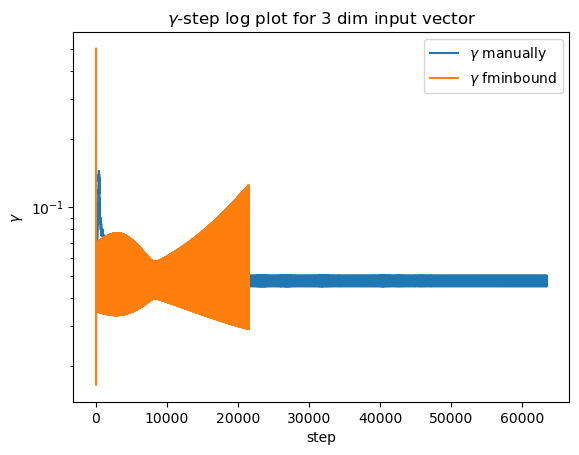

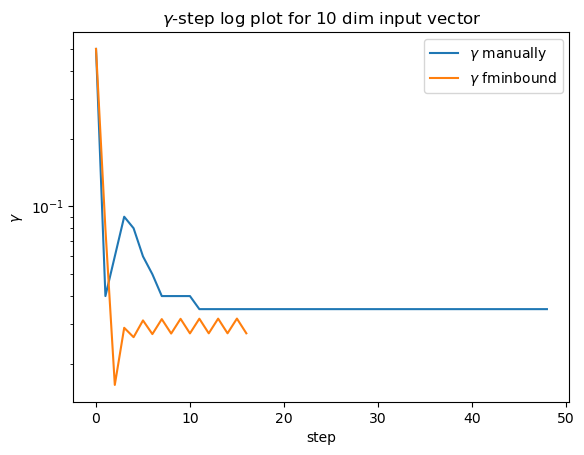

In [60]:
dfs3 = [df_3c1, df_3c2, df_3c3, df_3c4, df_3c5]
dfs10 = [df_10c1, df_10c2, df_10c3, df_10c4, df_10c5]
labels = ['$\gamma$ manually', '$\gamma$ fminbound', '$\gamma$ = 0.1',
          '$\gamma$ = 0.5', '$\gamma$ = 1']
for i in range(2):
    plt.plot(dfs3[i].step, dfs3[i].gamma, label=labels[i])
plt.yscale('log')
plt.xlabel('step')
plt.ylabel('$\gamma$')
plt.title('$\gamma$-step log plot for 3 dim input vector')
plt.legend()
plt.show()

for i in range(2):
    plt.plot(dfs10[i].step, dfs10[i].gamma, label=labels[i])
plt.yscale('log')
plt.xlabel('step')
plt.ylabel('$\gamma$')
plt.title('$\gamma$-step log plot for 10 dim input vector')
plt.legend()
plt.show()

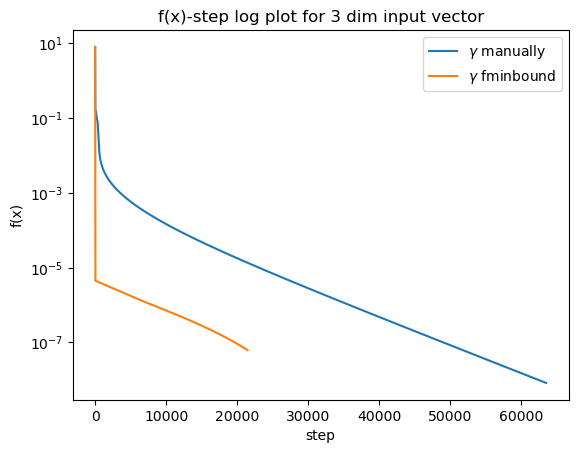

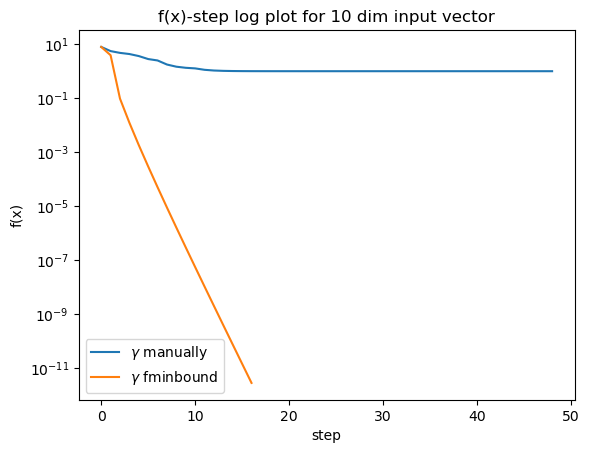

In [61]:
for i in range(2):
    plt.plot(dfs3[i].step, dfs3[i].f, label=labels[i])
# plt.xscale('log')
plt.yscale('log')
plt.xlabel('step')
plt.ylabel('f(x)')
plt.title('f(x)-step log plot for 3 dim input vector')
plt.legend()
plt.show()

for i in range(2):
    plt.plot(dfs10[i].step, dfs10[i].f, label=labels[i])
# plt.xscale('log')
plt.yscale('log')
plt.xlabel('step')
plt.ylabel('f(x)')
plt.title('f(x)-step log plot for 10 dim input vector')
plt.legend()
plt.show()

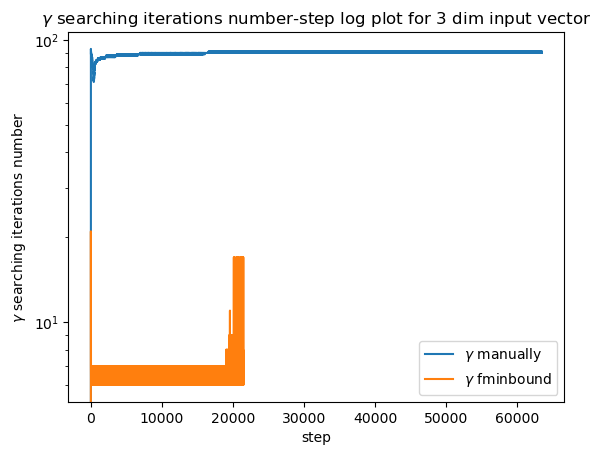

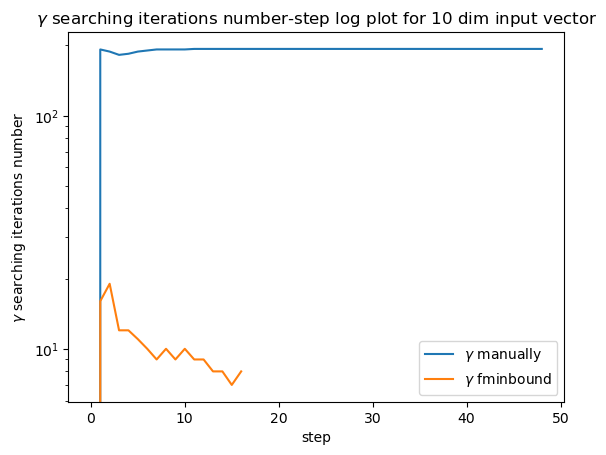

In [62]:
for i in range(2):
    plt.plot(dfs3[i].step, dfs3[i].k1, label=labels[i])
plt.yscale('log')
plt.xlabel('step')
plt.ylabel('$\gamma$ searching iterations number')
plt.title('$\gamma$ searching iterations number-step log plot for 3 dim input vector')
plt.legend()
plt.show()

for i in range(2):
    plt.plot(dfs10[i].step, dfs10[i].k1, label=labels[i])
plt.yscale('log')
plt.xlabel('step')
plt.ylabel('$\gamma$ searching iterations number')
plt.title(
    '$\gamma$ searching iterations number-step log plot for 10 dim input vector')
plt.legend()
plt.show()

## Report

According to this research, we can consider that

1.   Steepest gradient descent with complicated function has bad convergence when Armiho condition used.
2.  If built-in library smart fminbound searching applied, we have good convergence with high-dimension input data.
3. If built-in library smart fminbound searching applied, number of iteration of gradient descent can decreased in **2-3**
 times with ratio to Armiho condition.
4. Fminbound approach has bigger accuracy in huge-dimension case.
5. Also in this task I tried use different stopping condition like norm of gradient and norm of $x^{k+1}$ and $x^{k}$ differences.
6. The opinion exist (my opiniion) that the fact about better convergence on huge-dimension input data can be explained with closest norm to searching optimal poitn $\mathbf{x^{\star}}$, but it's not true because to $x^0$ for 3 and 10 dimension data spectral norm equal to $2.5$
 